In [92]:
import pandas as pd
import numpy as np

In [93]:
df = pd.read_csv('Reviews.csv')

In [94]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [95]:
df[['ProductId','UserId','Time','Score','Text','Summary']].head()

,ProductId,UserId,Time,Score,Text,Summary
0,B001E4KFG0,A3SGXH7AUHU8GW,1303862400,5,I have bought several of the Vitality canned d...,Good Quality Dog Food
1,B00813GRG4,A1D87F6ZCVE5NK,1346976000,1,Product arrived labeled as Jumbo Salted Peanut...,Not as Advertised
2,B000LQOCH0,ABXLMWJIXXAIN,1219017600,4,This is a confection that has been around a fe...,"""Delight"" says it all"
3,B000UA0QIQ,A395BORC6FGVXV,1307923200,2,If you are looking for the secret ingredient i...,Cough Medicine
4,B006K2ZZ7K,A1UQRSCLF8GW1T,1350777600,5,Great taffy at a great price. There was a wid...,Great taffy


In [96]:
df.shape

(568454, 10)

In [97]:
df.dtypes

Id                         int64
ProductId                 object
UserId                    object
ProfileName               object
HelpfulnessNumerator       int64
HelpfulnessDenominator     int64
Score                      int64
Time                       int64
Summary                   object
Text                      object
dtype: object

Let's add the **Sentiment** column that turns the numeric score into either *positive* or *negative*.

and  **Senti_Vect** column, 1 for 'positive' and 0 for 'negative'

Because the review of 3 is more neutral, we ignore the review with a score of 3

In [98]:

def categorise(row):  
    if row['Score'] > 3:
        return "positive"
    elif row['Score'] < 3:
        return "negative"

In [99]:
df['Sentiment'] = df.apply(lambda row: categorise(row), axis=1)

In [100]:
df = df[df.Score != 3]
df['Senti_Vect'] = [1 if x =='positive' else 0 for x in df['Sentiment']]

In [101]:
df = df[['Score','Sentiment','Summary','Text','Senti_Vect']]

In [102]:
df.head()

,Score,Sentiment,Summary,Text,Senti_Vect
0,5,positive,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,1,negative,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,0
2,4,positive,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,2,negative,Cough Medicine,If you are looking for the secret ingredient i...,0
4,5,positive,Great taffy,Great taffy at a great price. There was a wid...,1


Let's have a look at some 5s:

In [103]:
df.loc[df['Score'] == 5]

,Score,Sentiment,Summary,Text,Senti_Vect
0,5,positive,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
4,5,positive,Great taffy,Great taffy at a great price. There was a wid...,1
6,5,positive,Great! Just as good as the expensive brands!,This saltwater taffy had great flavors and was...,1
7,5,positive,"Wonderful, tasty taffy",This taffy is so good. It is very soft and ch...,1
8,5,positive,Yay Barley,Right now I'm mostly just sprouting this so my...,1
...,...,...,...,...,...
568448,5,positive,Very large ground spice jars.,My only complaint is that there's so much of i...,1
568449,5,positive,Will not do without,Great for sesame chicken..this is a good if no...,1
568451,5,positive,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o...",1
568452,5,positive,Favorite Training and reward treat,These are the BEST treats for training and rew...,1


And some 1s as well:

In [104]:
df.loc[df['Score'] == 1]

,Score,Sentiment,Summary,Text,Senti_Vect
1,1,negative,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,0
12,1,negative,My Cats Are Not Fans of the New Food,My cats have been happily eating Felidae Plati...,0
26,1,negative,Nasty No flavor,"The candy is just red , No flavor . Just plan...",0
50,1,negative,Don't like it,"This oatmeal is not good. Its mushy, soft, I d...",0
62,1,negative,stale product.,Arrived in 6 days and were so stale i could no...,0
...,...,...,...,...,...
568402,1,negative,alternative sweetner,"I was disappointed in this product, as I had r...",0
568426,1,negative,rip off,"The candy is tasty, but they totally scam you ...",0
568431,1,negative,Mostly water,Definitely not worth buying flavored water wit...,0
568432,1,negative,No Good,I thought this soup would be more like a chill...,0


## Cleaning the data

To format our data and build the Term-doc incidence matrix, many operations will be performed on the data :

- Stop words removal
- Stemming
- Punctuations
- Lowering

In [105]:
#stop words removal
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/mingcanli/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [106]:
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))  #stopwords list
print(stop_words)

{'to', 'yours', 'mustn', 'it', 'who', 'how', "hadn't", 'are', "wouldn't", 'didn', 'o', 'only', 'yourself', 'does', "needn't", "should've", "wasn't", "shan't", 'mightn', 'were', 'those', 'some', 'before', 'after', 'but', 'i', 'further', "isn't", 'do', "don't", 'the', "won't", 'themselves', 'all', 'wasn', 'while', 'hasn', 'myself', 'shouldn', 'this', 'not', 'her', 'up', 'doesn', "doesn't", 'such', 'my', 'at', 'most', 'be', 'has', 'same', 'what', "weren't", 'when', 'more', 'against', 'whom', 've', 'couldn', "that'll", "mustn't", 'shan', 're', 'once', 'during', 'have', 'theirs', 'which', 'by', 'did', 'ain', 't', 'ours', 'and', 'itself', 'he', 'as', 'into', 'they', 'on', "you'll", 'or', 'about', 'any', 'because', 'weren', 'y', 'was', 'herself', 'she', 'being', 'now', 'is', 's', 'd', 'too', 'where', 'of', 'm', 'hadn', 'under', 'had', 'each', 'haven', 'you', "it's", 'these', 'down', 'in', 'having', "you'd", "haven't", 'there', "hasn't", 'ma', 'here', 'through', 'him', 'ourselves', 'we', 'its'

In [107]:
'not' in stop_words

True

In [108]:
#stemming
from nltk.stem import PorterStemmer
ps = PorterStemmer()

In [109]:
print(ps.stem('tasty'))
print(ps.stem('joined'))
print(ps.stem('apples'))

tasti
join
appl


In [110]:
#Punctuations Removal
from string import punctuation
sentence = "I'd like to have some coffee today!"
sentence = sentence.translate(str.maketrans('','',punctuation))
print(sentence)

Id like to have some coffee today


In [111]:
#combine all steps and clean text
from nltk.stem import PorterStemmer
from string import punctuation
def cleanup(sentence):
    sentence = str(sentence)
    sentence = sentence.lower()
    sentence = sentence.translate(str.maketrans('','',punctuation))
    ps = PorterStemmer()
    sentence_spl = sentence.split()
    out = []
    for word in sentence_spl:
        out.append(ps.stem(word))
    #print(out)
    out = ' '.join(out)
    return out

In [112]:
cleanup("I'd like to have some coffee today! Hope this is tasty!")

'id like to have some coffe today hope thi is tasti'

In [113]:
df["Summary_Clean"] = df['Summary'].apply(cleanup)
df.head()

,Score,Sentiment,Summary,Text,Senti_Vect,Summary_Clean
0,5,positive,Good Quality Dog Food,I have bought several of the Vitality canned d...,1,good qualiti dog food
1,1,negative,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,0,not as advertis
2,4,positive,"""Delight"" says it all",This is a confection that has been around a fe...,1,delight say it all
3,2,negative,Cough Medicine,If you are looking for the secret ingredient i...,0,cough medicin
4,5,positive,Great taffy,Great taffy at a great price. There was a wid...,1,great taffi


### WordClouds

In [114]:
highscore = df["Summary_Clean"].loc[df.Sentiment == 'positive']
highscore.shape

(443777,)

In [115]:
highscore.shape

(443777,)

In [116]:
fre_dist_highscore = nltk.FreqDist(highscore.values)
print(fre_dist_highscore.most_common(20))

[('delici', 6341), ('yummi', 4488), ('great product', 3769), ('yum', 3093), ('love it', 2722), ('great', 2429), ('excel', 2137), ('good stuff', 1985), ('great coffe', 1803), ('awesom', 1797), ('the best', 1665), ('great tast', 1594), ('amaz', 1293), ('veri good', 1276), ('tasti', 1250), ('excel product', 1115), ('great stuff', 1091), ('great tea', 1084), ('wonder', 1050), ('fantast', 908)]


In [117]:
lowscore = df["Summary_Clean"].loc[df.Sentiment == 'negative']
lowscore.shape

(82037,)

In [118]:
fre_dist_lowscore = nltk.FreqDist(lowscore.values)
print(fre_dist_lowscore.most_common(20))

[('disappoint', 1190), ('yuck', 711), ('not good', 334), ('disgust', 323), ('aw', 322), ('horribl', 322), ('veri disappoint', 318), ('terribl', 295), ('gross', 254), ('made in china', 220), ('not what i expect', 219), ('filler food is empti leav your cat alway need more', 199), ('nasti', 179), ('not for me', 178), ('stale', 170), ('not so good', 165), ('dont wast your money', 162), ('rip off', 153), ('meh', 145), ('buyer bewar', 143)]


In [119]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
from wordcloud import WordCloud, STOPWORDS

#mpl.rcParams['figure.figsize']=(8.0,6.0)    #(6.0,4.0)
mpl.rcParams['font.size']=12                #10 
mpl.rcParams['savefig.dpi']=100             #72 
mpl.rcParams['figure.subplot.bottom']=.1 

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=None,
        max_words=1000,
        max_font_size=40, 
        scale=40,
        random_state=42 
    ).generate(str(data))
    
    fig = plt.figure(1, figsize=(8, 8))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

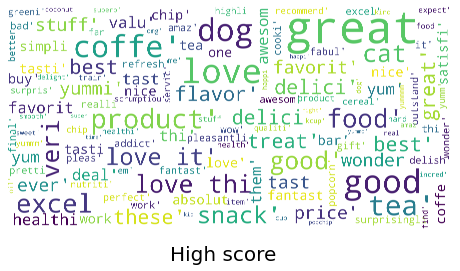

In [120]:
show_wordcloud(fre_dist_highscore.most_common(200), title = "High score")

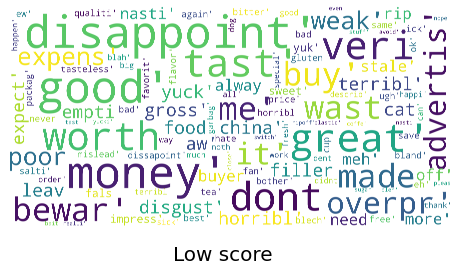

In [121]:
show_wordcloud(fre_dist_lowscore.most_common(100), title = "Low score")

In [122]:
#since lowscore and highscore class is imbalance
#randomly select from highscore and make its size equal to lowscore
randomhighscore = df.loc[df['Sentiment'] == 'positive'].sample(n=len(lowscore), random_state=None)
randomhighscore

,Score,Sentiment,Summary,Text,Senti_Vect,Summary_Clean
137329,5,positive,My dog loves these,"My dog is a very fussy eater, but loves these....",1,my dog love these
475146,5,positive,Lemon flavored cookies - YUM!,I found the lemon flavored Nonni's Biscotti at...,1,lemon flavor cooki yum
62169,4,positive,Very good!,I wish I could afford to buy this salmon all t...,1,veri good
320279,5,positive,"Deep, Dark, and Delicious",This Starbucks instant coffee is delicious! I...,1,deep dark and delici
59453,5,positive,"Apples, Cranberries and Cinnamon without Fatte...",The graphics on these bags are very enticing -...,1,appl cranberri and cinnamon without fatten nut
...,...,...,...,...,...,...
501717,5,positive,"Great for Tapenade, Hummus or Other Spreads","Lately, I have been on the prowl for Greek pro...",1,great for tapenad hummu or other spread
486570,4,positive,"Tastes ok, good for ya!",This tea was surprisingly hard to find at the ...,1,tast ok good for ya
381624,5,positive,Cake of the month club,I bought this as a gift for my brothers family...,1,cake of the month club
256481,5,positive,Gift for Father-in-Law,These were a gift for my Father-in-Law. His c...,1,gift for fatherinlaw


In [123]:
#merge the selected highscore and lowscore class to be the new dataset
result = randomhighscore.append(df.loc[df['Sentiment'] == 'negative'])
result

/var/folders/7s/bb3wqslj30l5qkfg8fm5wbzc0000gn/T/ipykernel_70769/2031876002.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  result = randomhighscore.append(df.loc[df['Sentiment'] == 'negative'])


,Score,Sentiment,Summary,Text,Senti_Vect,Summary_Clean
137329,5,positive,My dog loves these,"My dog is a very fussy eater, but loves these....",1,my dog love these
475146,5,positive,Lemon flavored cookies - YUM!,I found the lemon flavored Nonni's Biscotti at...,1,lemon flavor cooki yum
62169,4,positive,Very good!,I wish I could afford to buy this salmon all t...,1,veri good
320279,5,positive,"Deep, Dark, and Delicious",This Starbucks instant coffee is delicious! I...,1,deep dark and delici
59453,5,positive,"Apples, Cranberries and Cinnamon without Fatte...",The graphics on these bags are very enticing -...,1,appl cranberri and cinnamon without fatten nut
...,...,...,...,...,...,...
568433,1,negative,Tastes horrible!,I just bought this soup today at my local groc...,0,tast horribl
568434,2,negative,Not so good,This soup is mostly broth. Although it has a k...,0,not so good
568435,2,negative,Where's the tortellini?,"It is mostly broth, with the advertised 3/4 cu...",0,where the tortellini
568446,2,negative,Mixed wrong,I had ordered some of these a few months back ...,0,mix wrong


### train test split

In [124]:
from sklearn.model_selection import train_test_split
x = result['Summary_Clean'].values
y = result['Senti_Vect'].values
train, test = train_test_split(result, test_size=0.2, random_state = 1)
#x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state = 0)
x_train = train['Summary_Clean'].values
x_test = test['Summary_Clean'].values
y_train = train['Senti_Vect'].values
y_test = test['Senti_Vect'].values
print("%d items in training data, %d in test data" % (len(x_train), len(x_test)))

131259 items in training data, 32815 in test data


In [125]:
x

array(['my dog love these', 'lemon flavor cooki yum', 'veri good', ...,
       'where the tortellini', 'mix wrong', 'disappoint'], dtype=object)

In [126]:
y

array([1, 1, 1, ..., 0, 0, 0])

# Ways to convert text to vector
## *1) Uni-gram BOW*

In [127]:
#1. unigram bag of words
from sklearn.feature_extraction.text import CountVectorizer 

In [128]:
unigram = CountVectorizer(ngram_range = (1,1), max_df = 0.5).fit(x_train)
unitrain = unigram.transform(x_train)
unitest = unigram.transform(x_test)

In [129]:
unitrain.shape

(131259, 16524)

In [130]:
uniwords = unigram.get_feature_names()
print(uniwords[10200:10230])

['oblig', 'obnoxi', 'obrian', 'obscen', 'obscur', 'observ', 'obsess', 'obsolesc', 'obsolet', 'obstruct', 'obtain', 'obviou', 'obvious', 'oc', 'occas', 'occasion', 'occasionon', 'occass', 'occassion', 'occup', 'occupi', 'ocean', 'ocf', 'ocha', 'oclock', 'ocoffe', 'oct', 'octan', 'octob', 'octopu']


/Users/mingcanli/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [131]:
len(uniwords)

16524

## *2) Bi-gram BOW*

In [132]:
#2. bi-gram bag of words
bigram = CountVectorizer(ngram_range = (2,2), max_df = 0.5).fit(x_train)
bitrain = bigram.transform(x_train)
bitest = bigram.transform(x_test)

In [133]:
bitrain.shape

(131259, 111772)

In [134]:
biwords = bigram.get_feature_names()
print(biwords[10100:10190])

['be purchas', 'be put', 'be rather', 'be read', 'be readi', 'be realli', 'be recal', 'be recycl', 'be red', 'be redneck', 'be reformul', 'be refriger', 'be regul', 'be releas', 'be remaind', 'be remov', 'be renam', 'be reorder', 'be repeat', 'be return', 'be right', 'be rock', 'be rush', 'be rye', 'be sad', 'be safe', 'be sane', 'be satisfi', 'be savor', 'be scam', 'be scd', 'be screw', 'be season', 'be seriou', 'be serv', 'be ship', 'be shot', 'be sick', 'be similar', 'be smokier', 'be so', 'be soft', 'be sold', 'be some', 'be someth', 'be sorri', 'be soupi', 'be speedyquick', 'be spici', 'be spoil', 'be spoiler', 'be spruce', 'be stale', 'be stalesoft', 'be stapl', 'be star', 'be stick', 'be still', 'be stronger', 'be su', 'be substandard', 'be substitut', 'be suitabl', 'be super', 'be sure', 'be surpris', 'be sway', 'be sweeter', 'be taken', 'be tasti', 'be tea', 'be tempt', 'be the', 'be their', 'be there', 'be thi', 'be think', 'be thirsti', 'be three', 'be thrill', 'be thrown', 

In [135]:
len(biwords)

111772

## *3) tri-gram BOW*


In [136]:
#3. TRi-gram bag of words
trigram = CountVectorizer(ngram_range = (3,3), max_df = 0.5).fit(x_train)
tritrain = trigram.transform(x_train)
tritest = trigram.transform(x_test)

In [137]:
tritrain.shape

(131259, 157600)

In [138]:
triwords = trigram.get_feature_names()
print(triwords[10100:10190])

['assolutament come in', 'assort and great', 'assort aroma cat', 'assort at great', 'assort but few', 'assort but qualiti', 'assort but tazo', 'assort buyer bewar', 'assort candi lie', 'assort doesnt match', 'assort fit the', 'assort flavor 1235', 'assort flavor 90ct', 'assort fruit gummi', 'assort fruit lollipop', 'assort gummi bear', 'assort hard candi', 'assort is stretch', 'assort lb bag', 'assort not guarante', 'assort of flavor', 'assort of tasti', 'assort sold by', 'assort sweet popsnot', 'assum lifetim of', 'assur shop at', 'astonish and ecstat', 'astound by price', 'astound true lemon', 'astring and sour', 'astring weak tea', 'astronaut ice cream', 'astronaut kung pao', 'astronaut to me', 'at 10 time', 'at 135 calori', 'at 15 if', 'at 180 degre', 'at 1918 case', 'at 20 not', 'at 2x the', 'at 321 packag', 'at 35 calori', 'at 45x the', 'at afford price', 'at age 23', 'at aisian market', 'at all all', 'at all and', 'at all artifici', 'at all as', 'at all at', 'at all bad', 'at al

In [139]:
len(triwords)

157600

## *4) tf-idf*


In [140]:
#4. tf-idf 
from sklearn.feature_extraction.text import TfidfVectorizer
tf = TfidfVectorizer(ngram_range = (3,3), max_df = 0.5)
tftrain=tf.fit_transform(x_train)
tftest=tf.transform(x_test)

In [141]:
tftrain.shape

(131259, 157600)

In [142]:
tfwords = tf.get_feature_names()
print(tfwords[10100:10190])

['assolutament come in', 'assort and great', 'assort aroma cat', 'assort at great', 'assort but few', 'assort but qualiti', 'assort but tazo', 'assort buyer bewar', 'assort candi lie', 'assort doesnt match', 'assort fit the', 'assort flavor 1235', 'assort flavor 90ct', 'assort fruit gummi', 'assort fruit lollipop', 'assort gummi bear', 'assort hard candi', 'assort is stretch', 'assort lb bag', 'assort not guarante', 'assort of flavor', 'assort of tasti', 'assort sold by', 'assort sweet popsnot', 'assum lifetim of', 'assur shop at', 'astonish and ecstat', 'astound by price', 'astound true lemon', 'astring and sour', 'astring weak tea', 'astronaut ice cream', 'astronaut kung pao', 'astronaut to me', 'at 10 time', 'at 135 calori', 'at 15 if', 'at 180 degre', 'at 1918 case', 'at 20 not', 'at 2x the', 'at 321 packag', 'at 35 calori', 'at 45x the', 'at afford price', 'at age 23', 'at aisian market', 'at all all', 'at all and', 'at all artifici', 'at all as', 'at all at', 'at all bad', 'at al

In [143]:
len(tfwords)

157600

In [144]:
#dict for each model
prediction = dict()
prob = dict()

In [145]:
#pip install eli5

## Applying Logistic regression learning method


In [146]:
## using tfidf for Logistic regression
from sklearn.linear_model import LogisticRegression
lr1 = LogisticRegression(max_iter=1000000000000000000000)
lr1.fit(tftrain, y_train)

from sklearn.metrics import recall_score, accuracy_score, confusion_matrix, f1_score, precision_score ,roc_auc_score, roc_curve
y_predict1 = lr1.predict(tftest)
prediction['logistic_tfidf'] = y_predict1
prob['logistic_tfidf'] = lr1.predict_proba(tftest)

print(confusion_matrix(y_test,y_predict1))
print('F1:',f1_score(y_test,y_predict1).round(2))
print('precision:',precision_score(y_test,y_predict1).round(2))
print('accuracy:',accuracy_score(y_test,y_predict1).round(2))
print('Recall:', recall_score(y_test,y_predict1).round(2))

[[ 7937  8309]
 [  663 15906]]
F1: 0.78
precision: 0.66
accuracy: 0.73
Recall: 0.96


In [147]:
import eli5
eli5.show_weights(estimator=lr1, 
                  feature_names=tfwords,
                 top=(20, 20))

Weight?,Feature
+4.250,is the best
+4.116,hard to find
+3.846,on the go
+3.762,of the best
+3.734,love thi stuff
+3.679,at great price
+3.646,cat love it
+3.609,on the market
+3.477,great tast and
+3.443,dog love these


In [148]:
## using bigram for Logistic regression

lr2 = LogisticRegression(max_iter=1000000000000000000000)
lr2.fit(bitrain, y_train)

y_predict2 = lr2.predict(bitest)
prediction['logistic_bigram'] = y_predict2
prob['logistic_bigram'] = lr2.predict_proba(bitest)

print(confusion_matrix(y_test,y_predict2))
print('F1:',f1_score(y_test,y_predict2).round(2))
print('precision:',precision_score(y_test,y_predict2).round(2))
print('accuracy:',accuracy_score(y_test,y_predict2).round(2))
print('Recall:', recall_score(y_test,y_predict2).round(2))

[[12065  4181]
 [ 1332 15237]]
F1: 0.85
precision: 0.78
accuracy: 0.83
Recall: 0.92


In [149]:
eli5.show_weights(estimator=lr2, 
                  feature_names=biwords,
                 top=(20, 20))

Weight?,Feature
+3.837,good stuff
+3.569,love thi
+3.462,perfect for
+3.446,great snack
+3.397,great tea
+3.290,great stuff
+3.269,good not
+3.263,delici and
+3.177,love these
+3.148,love them


In [150]:
## using unigram for Logistic regression

lr3 = LogisticRegression(max_iter=1000000000000000000000)
lr3.fit(unitrain, y_train)

y_predict3 = lr3.predict(unitest)
prediction['logistic_unigram'] = y_predict3
prob['logistic_unigram'] = lr3.predict_proba(unitest)

print(confusion_matrix(y_test,y_predict3))
print('F1:',f1_score(y_test,y_predict3).round(2))
print('precision:',precision_score(y_test,y_predict3).round(2))
print('accuracy:',accuracy_score(y_test,y_predict3).round(2))
print('Recall:', recall_score(y_test,y_predict3).round(2))

[[14427  1819]
 [ 2035 14534]]
F1: 0.88
precision: 0.89
accuracy: 0.88
Recall: 0.88


In [151]:
eli5.show_weights(estimator=lr3, 
                  feature_names=uniwords,
                 top=(20, 20))

Weight?,Feature
+4.472,fantast
+4.266,smooth
+4.048,excel
+4.039,fabul
+4.032,delici
+3.908,yummi
+3.785,yum
+3.666,awesom
+3.656,perfect
+3.648,outstand


In [152]:
## using trigram for Logistic regression

lr4 = LogisticRegression(max_iter=1000000000000000000000)
lr4.fit(tritrain, y_train)

y_predict7 = lr4.predict(tritest)
prediction['logistic_trigram'] = y_predict7
prob['logistic_trigram'] = lr4.predict_proba(tritest)

print(confusion_matrix(y_test,y_predict7))
print('F1:',f1_score(y_test,y_predict7).round(2))
print('precision:',precision_score(y_test,y_predict7).round(2))
print('accuracy:',accuracy_score(y_test,y_predict7).round(2))
print('Recall:', recall_score(y_test,y_predict7).round(2))

[[ 7906  8340]
 [  624 15945]]
F1: 0.78
precision: 0.66
accuracy: 0.73
Recall: 0.96


In [153]:
eli5.show_weights(estimator=lr4, 
                  feature_names=triwords,
                 top=(20, 20))

Weight?,Feature
+3.147,love thi tea
+3.118,love thi stuff
+2.861,dog love these
+2.844,simpli the best
+2.840,cat love it
+2.811,hard to find
+2.709,at great price
+2.704,these are great
+2.677,love thi coffe
+2.651,of the best


## Results of logistics regression

to compare our learning algorithms, we build the ROC curve. The curve with the highest AUC value will show the "best" algorithm.

In [154]:
from sklearn import metrics
from sklearn.metrics import roc_curve, auc

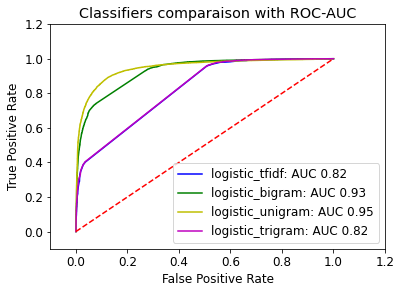

In [155]:
cmp = 0
colors = ['b', 'g', 'y', 'm', 'k', 'p','r','c']
for model, predicted in prediction.items():
    false_positive_rate, true_positive_rate, thresholds = \
            roc_curve(test['Sentiment'].values, prob[model][:,1], pos_label = 'positive')
    roc_auc = auc(false_positive_rate, true_positive_rate)
    plt.plot(false_positive_rate, true_positive_rate, colors[cmp], label='%s: AUC %0.2f'% (model,roc_auc))
    cmp += 1

plt.title('Classifiers comparaison with ROC-AUC')
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

## Applying RandomForest method

In [156]:
from sklearn.ensemble import RandomForestClassifier

In [157]:
classifier = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)

In [158]:
classifier.fit(tftrain, y_train)

RandomForestClassifier(criterion='entropy', n_estimators=10, random_state=0)

In [159]:
##using tfidf for random forest
y_predict4 = classifier.predict(tftest)
prediction['rf_tfidf'] = y_predict4
prob['rf_tfidf'] = classifier.predict_proba(tftest)

print(confusion_matrix(y_test,y_predict4))
print('F1:',f1_score(y_test,y_predict4).round(2))
print('precision:',precision_score(y_test,y_predict4).round(2))
print('accuracy:',accuracy_score(y_test,y_predict4).round(2))
print('Recall:', recall_score(y_test,y_predict4).round(2))

[[ 7739  8507]
 [  662 15907]]
F1: 0.78
precision: 0.65
accuracy: 0.72
Recall: 0.96


In [160]:
##using bigram for random forest
classifier2 = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
classifier2.fit(bitrain, y_train)

y_predict5 = classifier2.predict(bitest)
prediction['rf_bigram'] = y_predict5
prob['rf_bigram'] = classifier2.predict_proba(bitest)

print(confusion_matrix(y_test,y_predict5))
print('F1:',f1_score(y_test,y_predict5).round(2))
print('precision:',precision_score(y_test,y_predict5).round(2))
print('accuracy:',accuracy_score(y_test,y_predict5).round(2))
print('Recall:', recall_score(y_test,y_predict5).round(2))

[[15148  1098]
 [ 4757 11812]]
F1: 0.8
precision: 0.91
accuracy: 0.82
Recall: 0.71


In [161]:
##using unigram for random forest
classifier3 = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
classifier3.fit(unitrain, y_train)

y_predict6 = classifier3.predict(unitest)
prediction['rf_unigram'] = y_predict6
prob['rf_unigram'] = classifier3.predict_proba(unitest)

print(confusion_matrix(y_test,y_predict6))
print('F1:',f1_score(y_test,y_predict6).round(2))
print('precision:',precision_score(y_test,y_predict6).round(2))
print('accuracy:',accuracy_score(y_test,y_predict6).round(2))
print('Recall:', recall_score(y_test,y_predict6).round(2))

[[14987  1259]
 [ 2025 14544]]
F1: 0.9
precision: 0.92
accuracy: 0.9
Recall: 0.88


In [162]:
##using trigram for random forest
classifier4 = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
classifier4.fit(tritrain, y_train)

y_predict8 = classifier4.predict(tritest)
prediction['rf_trigram'] = y_predict8
prob['rf_trigram'] = classifier4.predict_proba(tritest)

print(confusion_matrix(y_test,y_predict8))
print('F1:',f1_score(y_test,y_predict8).round(2))
print('precision:',precision_score(y_test,y_predict8).round(2))
print('accuracy:',accuracy_score(y_test,y_predict8).round(2))
print('Recall:', recall_score(y_test,y_predict8).round(2))

[[ 7736  8510]
 [  608 15961]]
F1: 0.78
precision: 0.65
accuracy: 0.72
Recall: 0.96


## Results of random forest and logistics regression
The curve with the highest AUC value will show the "best" algorithm.

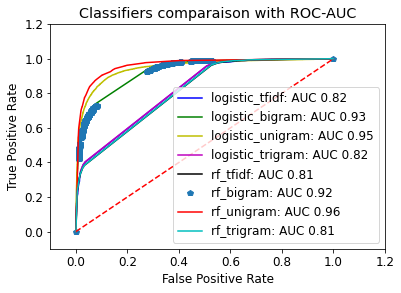

In [163]:
cmp = 0
colors = ['b', 'g', 'y', 'm', 'k','p','r','c']
for model, predicted in prediction.items():
    false_positive_rate, true_positive_rate, thresholds = \
            roc_curve(test['Sentiment'].values, prob[model][:,1], pos_label = 'positive')
    roc_auc = auc(false_positive_rate, true_positive_rate)
    plt.plot(false_positive_rate, true_positive_rate, colors[cmp], label='%s: AUC %0.2f'% (model,roc_auc))
    cmp += 1

plt.title('Classifiers comparaison with ROC-AUC')
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [164]:
# plot for tifdf random forest
estimator = classifier.estimators_[5]

from sklearn.tree import export_graphviz
from sklearn import tree
import graphviz
# Export as dot file
#exported=tree.
export_graphviz(estimator, out_file='tree.dot', 
                
                class_names=['Negative','Positive'],
                max_depth = 8,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree.png')

In [165]:
# plot for unigram random forest
estimator = classifier2.estimators_[5]

from sklearn.tree import export_graphviz
from sklearn import tree
import graphviz
# Export as dot file
#exported=tree.
export_graphviz(estimator, out_file='tree1.dot', 
                
                class_names=['Negative','Positive'],
                max_depth = 8,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree1.dot', '-o', 'tree1.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree1.png')

In [166]:
# plot for bigram random forest
estimator = classifier3.estimators_[5]

from sklearn.tree import export_graphviz
from sklearn import tree
import graphviz
# Export as dot file
#exported=tree.
export_graphviz(estimator, out_file='tree2.dot', 
                
                class_names=['Negative','Positive'],
                max_depth = 8,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree2.dot', '-o', 'tree2.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree2.png')

In [167]:
# plot for trigram random forest
estimator = classifier4.estimators_[5]

from sklearn.tree import export_graphviz
from sklearn import tree
import graphviz
# Export as dot file
#exported=tree.
export_graphviz(estimator, out_file='tree3.dot', 
                
                class_names=['Negative','Positive'],
                max_depth = 8,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

from subprocess import call
call(['dot', '-Tpng', 'tree3.dot', '-o', 'tree3.png', '-Gdpi=600'])

from IPython.display import Image
Image(filename = 'tree3.png')